# More Advanced ML methods

In [1]:
import pandas as pd
import numpy as np
loan = pd.read_csv('loan.csv')
loan.head(2)

,Loan_ID,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status
0,LP001002,Male,No,0,Graduate,No,5849,0.0,NaN,360.0,1.0,Urban,Y
1,LP001003,Male,Yes,1,Graduate,No,4583,1508.0,128.0,360.0,1.0,Rural,N


In [2]:
loan.isna().sum()

Loan_ID               0
Gender               13
Married               3
Dependents           15
Education             0
Self_Employed        32
ApplicantIncome       0
CoapplicantIncome     0
LoanAmount           22
Loan_Amount_Term     14
Credit_History       50
Property_Area         0
Loan_Status           0
dtype: int64

In [3]:
loan = loan.dropna()
loan.columns

Index(['Loan_ID', 'Gender', 'Married', 'Dependents', 'Education',
       'Self_Employed', 'ApplicantIncome', 'CoapplicantIncome', 'LoanAmount',
       'Loan_Amount_Term', 'Credit_History', 'Property_Area', 'Loan_Status'],
      dtype='object')

In [4]:
x = loan[['Gender', 'Married', 'Dependents', 'Education','Self_Employed', 
          'ApplicantIncome', 'CoapplicantIncome', 'LoanAmount','Loan_Amount_Term',
          'Credit_History', 'Property_Area']]
x = pd.get_dummies(x)
y = loan['Loan_Status'].map({'Y': 1, 'N': 0})
x.shape

(480, 20)

In [5]:

from sklearn.model_selection import train_test_split
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score, roc_auc_score

# Assuming you have a DataFrame 'X' with features and 'y' with labels/target
# Replace X and y with your actual data
X_train, X_temp, y_train, y_temp = train_test_split(x, y, test_size=0.3, random_state=42)
X_test, X_val, y_test, y_val = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Define the range of k values
k_values = list(range(6, 17, 2))

# Create a list to store dictionaries of results
results_list = []

for k in k_values:
    # Feature selection using SelectKBest with f_classif scoring
    selector = SelectKBest(f_classif, k=k)

    X_train_selected = selector.fit_transform(X_train, y_train)
    X_test_selected = selector.transform(X_test)
    X_val_selected = selector.transform(X_val)

    # Initialize the Gradient Boosting Classifier
    gb_classifier = GradientBoostingClassifier(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)

    # Train the model on the training set with selected features
    gb_classifier.fit(X_train_selected, y_train)

    # Predictions on the training set
    y_train_pred = gb_classifier.predict(X_train_selected)

    # Predictions on the test set
    y_test_pred = gb_classifier.predict(X_test_selected)

    # Predictions on the validation set
    y_val_pred = gb_classifier.predict(X_val_selected)

    # Calculate accuracy for training set
    accuracy_train = accuracy_score(y_train, y_train_pred)

    # Calculate accuracy for test set
    accuracy_test = accuracy_score(y_test, y_test_pred)

    # Calculate accuracy for validation set
    accuracy_val = accuracy_score(y_val, y_val_pred)

    # Calculate AUC for training set
    auc_train = roc_auc_score(y_train, gb_classifier.predict_proba(X_train_selected)[:, 1])

    # Calculate AUC for test set
    auc_test = roc_auc_score(y_test, gb_classifier.predict_proba(X_test_selected)[:, 1])

    # Calculate AUC for validation set
    auc_val = roc_auc_score(y_val, gb_classifier.predict_proba(X_val_selected)[:, 1])

    # Append results to the list
    results_list.append({
        'k': k,
        'Accuracy Train': accuracy_train,
        'Accuracy Test': accuracy_test,
        'Accuracy Validation': accuracy_val,
        'AUC Train': auc_train,
        'AUC Test': auc_test,
        'AUC Validation': auc_val
    })

# Convert the list of dictionaries to a DataFrame
results_df = pd.DataFrame(results_list)
results_df

,k,Accuracy Train,Accuracy Test,Accuracy Validation,AUC Train,AUC Test,AUC Validation
0,6,0.877976,0.750000,0.791667,0.949768,0.736596,0.690169
1,8,0.886905,0.708333,0.805556,0.941769,0.744255,0.684211
2,10,0.907738,0.763889,0.791667,0.993555,0.731064,0.671301
3,12,0.922619,0.736111,0.791667,0.993286,0.733617,0.703078
4,14,0.907738,0.722222,0.791667,0.992664,0.728511,0.753724
5,16,0.910714,0.750000,0.791667,0.993037,0.735319,0.735849


In [6]:
!pip install xgboost

In [7]:
from xgboost import XGBClassifier
X_train, X_temp, y_train, y_temp = train_test_split(x, y, test_size=0.3, random_state=42)
X_test, X_val, y_test, y_val = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Define the range of k values
k_values = list(range(6, 17, 2))

# Create a list to store dictionaries of results
results_list = []

for k in k_values:
    # Feature selection using SelectKBest with f_classif scoring
    selector = SelectKBest(f_classif, k=k)

    X_train_selected = selector.fit_transform(X_train, y_train)
    X_test_selected = selector.transform(X_test)
    X_val_selected = selector.transform(X_val)

    # Initialize the XGBoost Classifier
    xgb_classifier = XGBClassifier(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)

    # Train the model on the training set with selected features
    xgb_classifier.fit(X_train_selected, y_train)

    # Predictions on the training set
    y_train_pred = xgb_classifier.predict(X_train_selected)

    # Predictions on the test set
    y_test_pred = xgb_classifier.predict(X_test_selected)

    # Predictions on the validation set
    y_val_pred = xgb_classifier.predict(X_val_selected)

    # Calculate accuracy for training set
    accuracy_train = accuracy_score(y_train, y_train_pred)

    # Calculate accuracy for test set
    accuracy_test = accuracy_score(y_test, y_test_pred)

    # Calculate accuracy for validation set
    accuracy_val = accuracy_score(y_val, y_val_pred)

    # Calculate AUC for training set
    auc_train = roc_auc_score(y_train, xgb_classifier.predict_proba(X_train_selected)[:, 1])

    # Calculate AUC for test set
    auc_test = roc_auc_score(y_test, xgb_classifier.predict_proba(X_test_selected)[:, 1])

    # Calculate AUC for validation set
    auc_val = roc_auc_score(y_val, xgb_classifier.predict_proba(X_val_selected)[:, 1])

    # Append results to the list
    results_list.append({
        'k': k,
        'Accuracy Train': accuracy_train,
        'Accuracy Test': accuracy_test,
        'Accuracy Validation': accuracy_val,
        'AUC Train': auc_train,
        'AUC Test': auc_test,
        'AUC Validation': auc_val
    })

# Convert the list of dictionaries to a DataFrame
results_df = pd.DataFrame(results_list)
results_df

,k,Accuracy Train,Accuracy Test,Accuracy Validation,AUC Train,AUC Test,AUC Validation
0,6,0.839286,0.777778,0.819444,0.905545,0.768511,0.709037
1,8,0.833333,0.763889,0.819444,0.909731,0.767234,0.723436
2,10,0.866071,0.750000,0.819444,0.962948,0.781277,0.679245
3,12,0.872024,0.750000,0.833333,0.965724,0.798298,0.688183
4,14,0.883929,0.708333,0.833333,0.968356,0.777872,0.688183
5,16,0.875000,0.750000,0.833333,0.963777,0.792340,0.685204


In [8]:
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, roc_auc_score

X_train, X_temp, y_train, y_temp = train_test_split(x, y, test_size=0.3, random_state=42)
X_test, X_val, y_test, y_val = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Define the range of k values
k_values = list(range(6, 17, 2))

# Create a list to store dictionaries of results
results_list = []

for k in k_values:
    # Feature selection using SelectKBest with f_classif scoring
    selector = SelectKBest(f_classif, k=k)

    X_train_selected = selector.fit_transform(X_train, y_train)
    X_test_selected = selector.transform(X_test)
    X_val_selected = selector.transform(X_val)

    # Standardize the features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train_selected)
    X_test_scaled = scaler.transform(X_test_selected)
    X_val_scaled = scaler.transform(X_val_selected)

    # Initialize the SVM model with an RBF kernel
    svm_classifier = SVC(kernel='rbf', C=1.0, gamma='scale', random_state=42)

    # Train the model on the scaled training set
    svm_classifier.fit(X_train_scaled, y_train)

    # Predictions on the training set
    y_train_pred = svm_classifier.predict(X_train_scaled)

    # Predictions on the test set
    y_test_pred = svm_classifier.predict(X_test_scaled)

    # Predictions on the validation set
    y_val_pred = svm_classifier.predict(X_val_scaled)

    # Calculate accuracy for training set
    accuracy_train = accuracy_score(y_train, y_train_pred)

    # Calculate accuracy for test set
    accuracy_test = accuracy_score(y_test, y_test_pred)

    # Calculate accuracy for validation set
    accuracy_val = accuracy_score(y_val, y_val_pred)

    # Calculate AUC for training set
    auc_train = roc_auc_score(y_train, svm_classifier.decision_function(X_train_scaled))

    # Calculate AUC for test set
    auc_test = roc_auc_score(y_test, svm_classifier.decision_function(X_test_scaled))

    # Calculate AUC for validation set
    auc_val = roc_auc_score(y_val, svm_classifier.decision_function(X_val_scaled))

    # Append results to the list
    results_list.append({
        'k': k,
        'Accuracy Train': accuracy_train,
        'Accuracy Test': accuracy_test,
        'Accuracy Validation': accuracy_val,
        'AUC Train': auc_train,
        'AUC Test': auc_test,
        'AUC Validation': auc_val
    })

# Convert the list of dictionaries to a DataFrame
results_df = pd.DataFrame(results_list)
results_df

,k,Accuracy Train,Accuracy Test,Accuracy Validation,AUC Train,AUC Test,AUC Validation
0,6,0.824405,0.763889,0.833333,0.752756,0.762979,0.619662
1,8,0.824405,0.763889,0.833333,0.773375,0.714043,0.506455
2,10,0.827381,0.750000,0.847222,0.818841,0.705532,0.678252
3,12,0.833333,0.750000,0.833333,0.806034,0.669787,0.716981
4,14,0.824405,0.763889,0.833333,0.837533,0.702128,0.850050
5,16,0.821429,0.763889,0.833333,0.840061,0.690213,0.835154


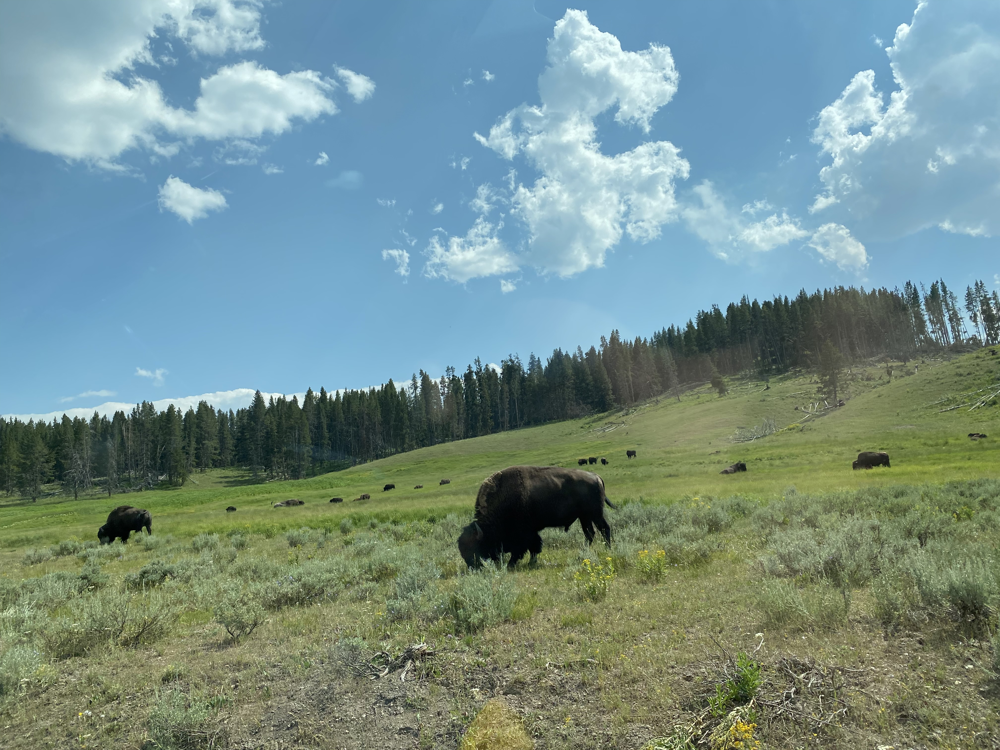

In [9]:
from PIL import Image
from IPython.display import display
# Replace 'your_image.jpg' with the path to your JPG image
image_path = 'bison.jpg'
# Open the image using Pillow
img = Image.open(image_path)
# Display the image
display(img)

In [10]:
bison_array = np.array(img)
bison_array.shape

(3024, 4032, 3)

In [11]:
bison_array[:2]

array([[[118, 154, 166],
        [118, 154, 166],
        [118, 154, 166],
        ...,
        [147, 193, 217],
        [147, 193, 217],
        [147, 193, 217]],

       [[118, 154, 166],
        [118, 154, 166],
        [118, 154, 166],
        ...,
        [147, 193, 217],
        [147, 193, 217],
        [147, 193, 217]]], dtype=uint8)

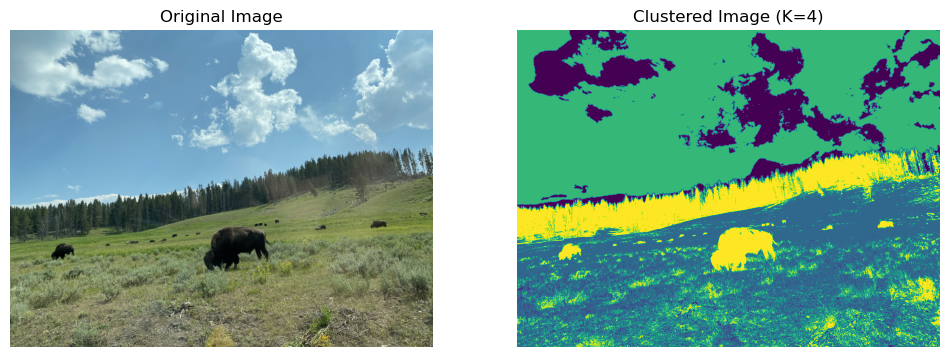

In [12]:
from PIL import Image
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Replace 'your_image.jpg' with the path to your JPG image
image_path = 'bison.jpg'

# Open the image using Pillow
img = Image.open(image_path)

# Convert the image to a NumPy array
img_array = np.array(img)

# Reshape the array to a flat 2D array (height x width, channels)
img_flat = img_array.reshape((-1, img_array.shape[-1]))

# Specify the number of clusters (replace with your desired number)
num_clusters = 4

# Perform K-Means clustering
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
kmeans.fit(img_flat)
labels = kmeans.labels_

# Reshape the labels to the shape of the original image
clustered_img = labels.reshape(img_array.shape[:2])

# Display the original and clustered images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

ax1.imshow(img)
ax1.set_title('Original Image')
ax1.axis('off')

ax2.imshow(clustered_img, cmap='viridis')  # You can choose a different colormap
ax2.set_title(f'Clustered Image (K={num_clusters})')
ax2.axis('off')

plt.show()


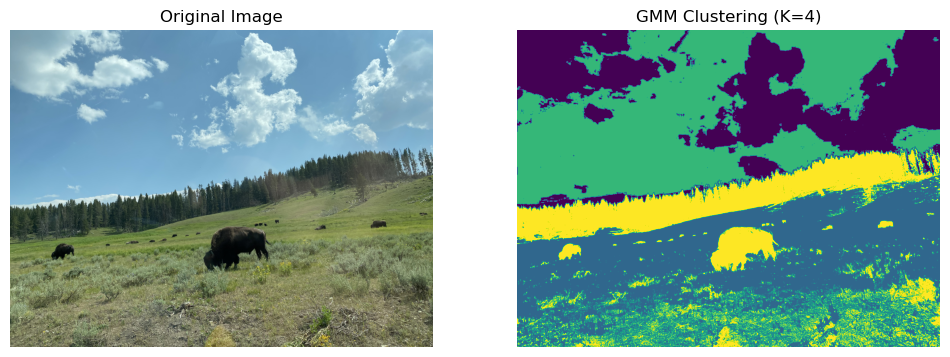

In [13]:
from PIL import Image
import numpy as np
from sklearn.mixture import GaussianMixture
import matplotlib.pyplot as plt

# Replace 'your_image.jpg' with the path to your JPG image
image_path = 'bison.jpg'

# Open the image using Pillow
img = Image.open(image_path)

# Convert the image to a NumPy array
img_array = np.array(img)

# Reshape the array to a flat 2D array (height x width, channels)
img_flat = img_array.reshape((-1, img_array.shape[-1]))

# Specify the number of components (clusters) in the GMM
num_components = 4  # Adjust as needed

# Fit a Gaussian Mixture Model to the data
gmm = GaussianMixture(n_components=num_components, random_state=42)
gmm.fit(img_flat)

# Predict cluster assignments for each data point
labels = gmm.predict(img_flat)

# Reshape the labels to the shape of the original image
clustered_img = labels.reshape(img_array.shape[:2])

# Display the original and clustered images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

ax1.imshow(img)
ax1.set_title('Original Image')
ax1.axis('off')

ax2.imshow(clustered_img, cmap='viridis')  # You can choose a different colormap
ax2.set_title(f'GMM Clustering (K={num_components})')
ax2.axis('off')

plt.show()


In [14]:
x['result'] = y
gmm = GaussianMixture(n_components=2, random_state=42) 
# Adjust the number of components as needed
gmm.fit(x)
# Compute log-likelihoods for all data points in 'df'
log_likelihoods = gmm.score_samples(x)

# Set a threshold for anomaly detection (e.g., 5th percentile)
threshold = np.percentile(log_likelihoods, 5)

# Identify anomalies
anomalies_mask = log_likelihoods < threshold
anomalies_df = x[anomalies_mask]

# Display the original DataFrame and anomalies
print("Original DataFrame:")
x.head()

print("\nAnomalies:")
anomalies_df


Original DataFrame:

Anomalies:


,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Gender_Female,Gender_Male,Married_No,Married_Yes,Dependents_0,...,Dependents_2,Dependents_3+,Education_Graduate,Education_Not Graduate,Self_Employed_No,Self_Employed_Yes,Property_Area_Rural,Property_Area_Semiurban,Property_Area_Urban,result
9,12841,10968.0,349.0,360.0,1.0,False,True,False,True,False,...,False,False,True,False,True,False,False,True,False,0
68,7100,0.0,125.0,60.0,1.0,False,True,False,True,False,...,False,True,False,True,False,True,False,False,True,1
122,2137,8980.0,137.0,360.0,0.0,True,False,True,False,True,...,False,False,True,False,True,False,False,True,False,1
135,4000,7750.0,290.0,360.0,1.0,False,True,False,True,False,...,False,True,True,False,True,False,False,True,False,0
155,39999,0.0,600.0,180.0,0.0,False,True,False,True,False,...,False,True,True,False,True,False,False,True,False,1
177,5516,11300.0,495.0,360.0,0.0,False,True,False,True,False,...,False,True,True,False,True,False,False,True,False,0
183,33846,0.0,260.0,360.0,1.0,False,True,False,True,False,...,False,False,True,False,True,False,False,True,False,0
185,39147,4750.0,120.0,360.0,1.0,False,True,False,True,True,...,False,False,True,False,False,True,False,True,False,1
242,2965,5701.0,155.0,60.0,1.0,False,True,True,False,True,...,False,False,True,False,True,False,False,False,True,1
253,2661,7101.0,279.0,180.0,1.0,False,True,False,True,False,...,False,False,False,True,True,False,False,True,False,1


# Deep Learning with TensorFlow and PyTorch
###  What is Deep Learning?

- **Definition:** A subfield of machine learning inspired by the brain.
- **Key concept:** Artificial neural networks learn from data.
- **Examples:** Image recognition, natural language processing, etc.

---

# Packages: Introduction to TensorFlow and PyTorch

- Open-source software libraries for deep learning.
- Provide tools for building, training, and deploying neural networks.
- **Shared functionalities:**
  - Tensor operations
  - Neural network building blocks
  - Automatic differentiation
  - Training tools
  - Deployment options

---

# Key Differences

| Feature       | TensorFlow                  | PyTorch                    |
|---------------|-----------------------------|----------------------------|
| Syntax        | Static computational graph  | Dynamic, Pythonic          |
| Ease of use   | Steeper learning curve      | Easier for beginners       |
| Focus         | Production-ready applications | Research and experimentation |

---

#  When to Choose Each Framework

- **TensorFlow:**
  - Large-scale projects
  - Production deployment
  - Familiarity with static graphs
  
- **PyTorch:**
  - Rapid prototyping
  - Research and experimentation
  - Preference for dynamic Pythonic syntax

---

# Getting Started with TensorFlow and PyTorch

- **Resources:**
  - TensorFlow tutorials: [link](https://www.tensorflow.org/tutorials)
  - PyTorch tutorials: [link](https://pytorch.org/tutorials/)
  - Online communities and forums



- TensorFlow and PyTorch are powerful tools for deep learning.
- Understanding their strengths and differences helps you choose the right fit for your project.
- Start exploring and unleash the potential of deep learning!

---


## Research vs Industry Use of TensorFlow and PyTorch

---

Both TensorFlow and PyTorch are widely used in deep learning, but their strengths cater to different needs in research and industry settings. Here's a comparison:

---

### Research

**TensorFlow:**

- Pros:
  - Strong community and ecosystem for research papers and code sharing.
  - Extensive support for distributed training on large datasets.
  - TensorFlow Research (TFR) with specialized tools for research, like eager execution and debugging.
  - Integration with Google Cloud Platform for scaling resources.
- Cons:
  - Can be less intuitive for beginners due to its static computational graph approach.
  - Less emphasis on dynamic experimentation compared to PyTorch.

**PyTorch:**

- Pros:
  - Dynamic computation graph makes it easier to experiment and prototype new architectures.
  - Pythonic syntax feels more natural for many researchers.
  - Large selection of pre-trained models and research libraries.
  - Active development and focus on cutting-edge deep learning methods.
- Cons:
  - Less mature ecosystem compared to TensorFlow for production deployment.
  - Distributed training capabilities are evolving but might not be as robust as TensorFlow's.

---

### Industry

**TensorFlow:**

- Pros:
  - Production-ready tools and libraries for deployment in real-world applications.
  - TensorFlow Serving simplifies model serving and inference.
  - Strong community support for industrial applications.
  - Integration with various cloud platforms and deployment tools.
- Cons:
  - Might be less flexible for rapid prototyping and experimentation compared to PyTorch.
  - Learning curve can be steeper for those unfamiliar with static computational graphs.

**PyTorch:**

- Pros:
  - Growing adoption in industry due to its flexibility and dynamic nature.
  - Integration with cloud platforms like AWS SageMaker and Azure Machine Learning.
  - Emerging ecosystem of libraries and tools for production deployment.
- Cons:
  - Production support and tools are still evolving compared to TensorFlow.
  - Might not be the best choice for large-scale deployments with complex requirements.

---

### Summary

- **Research:** Both are popular, but PyTorch tends to be preferred for its flexibility and prototyping advantages in research settings. However, TensorFlow's research-specific tools and extensive community are also valuable.
- **Industry:** TensorFlow currently dominates due to its strong production capabilities and mature ecosystem. However, PyTorch is gaining traction thanks to its ease of use and growing industry adoption.
- Ultimately, the best choice depends on your specific project needs and priorities. Consider factors like the scale of your project, your development team's familiarity with each framework, and the importance of flexibility vs. production readiness.

